In [1]:
import matplotlib.pyplot as plt
import cortex
import numpy as np
from glob import glob

%matplotlib inline

In [2]:
# Run this cell to download fsaverage surface for pycortex, labeled by Mark Lescroart
# cortex.utils.download_subject(subject_id='fsaverage')

In [11]:
# We are going to compute median tSNR across all runs.
# We already pre-computed it for each subject, so we just need to
# load those files and then compute the median across subjects.
median_tsnr_left = sorted(glob('../outputs/datapaper/tsnr/sub-*/*median*hemi-L*npy'))
median_tsnr_right = sorted(glob('../outputs/datapaper/tsnr/sub-*/*median*hemi-R*npy'))

assert len(median_tsnr_left) == 24
assert len(median_tsnr_right) == 24

In [17]:
median_tsnr_both = []
for left, right in zip(median_tsnr_left, median_tsnr_right):
    median_tsnr_both.append(np.hstack((np.load(left), np.load(right))))

In [19]:
median_tsnr_across_subjects = np.median(median_tsnr_both, 0)

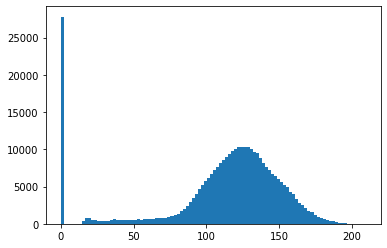

In [20]:
plt.hist(median_tsnr_across_subjects, bins=100);

TypeError: ufunc 'isfinite' not supported for the input types, and the inputs could not be safely coerced to any supported types according to the casting rule ''safe''

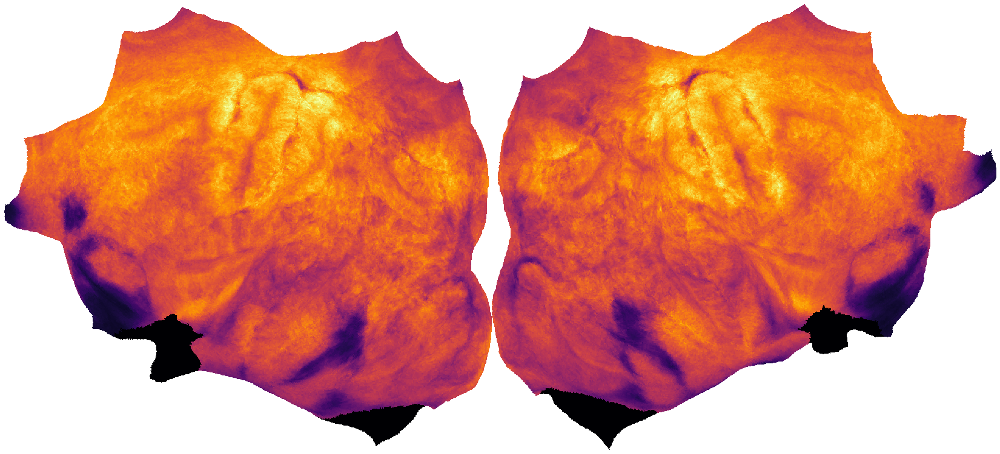

In [24]:
cortex.quickflat.make_figure(data, with_rois=False, colorbar_location='right');

Generating a flatmap cache


/home/contematto/miniconda3/envs/budapest/lib/python3.8/site-packages/cortex/quickflat/view.py:111: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/home/contematto/miniconda3/envs/budapest/lib/python3.8/site-packages/cortex/quickflat/view.py:111: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/home/contematto/miniconda3/envs/budapest/lib/python3.8/site-packages/cortex/quickflat/view.py:111: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.

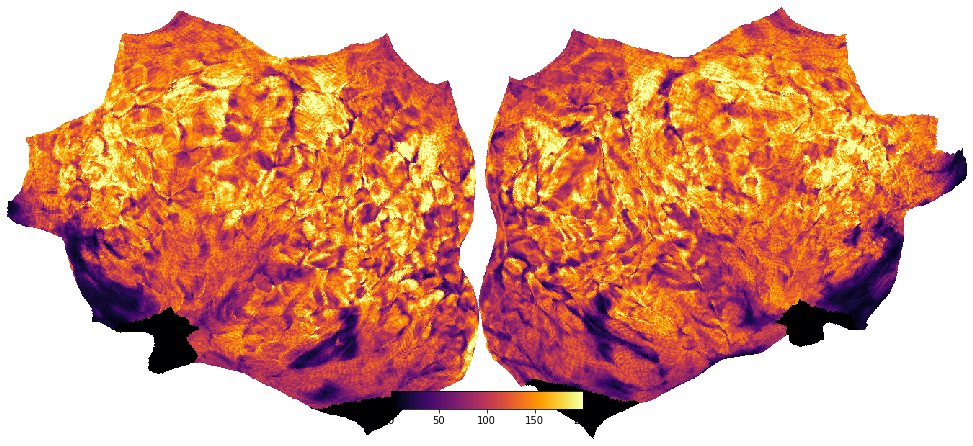

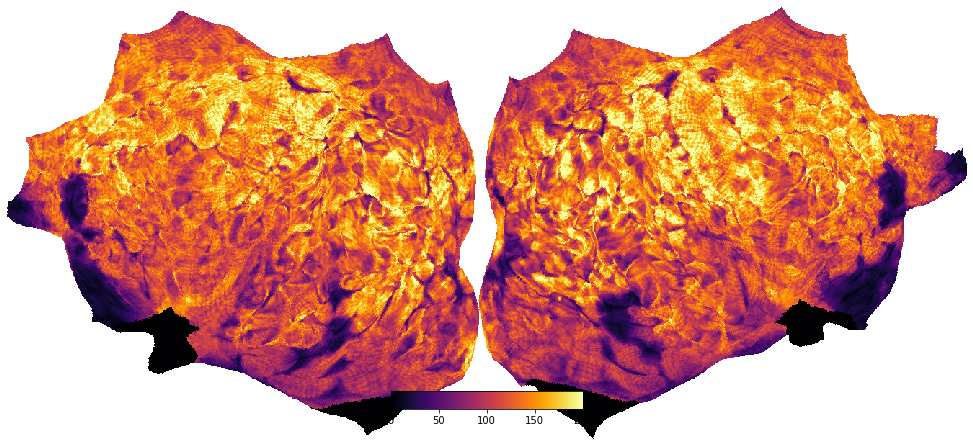

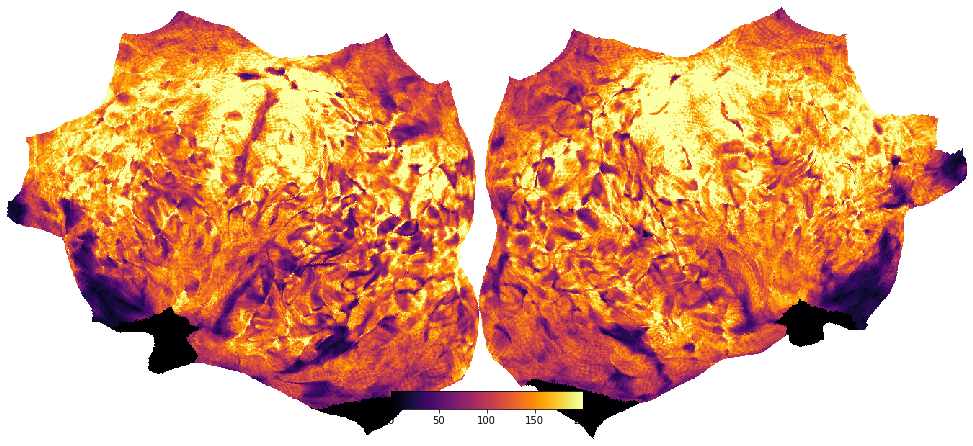

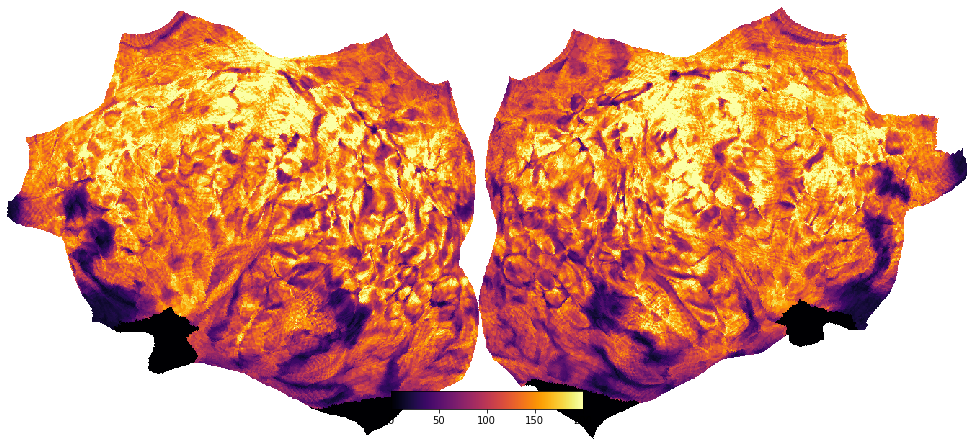

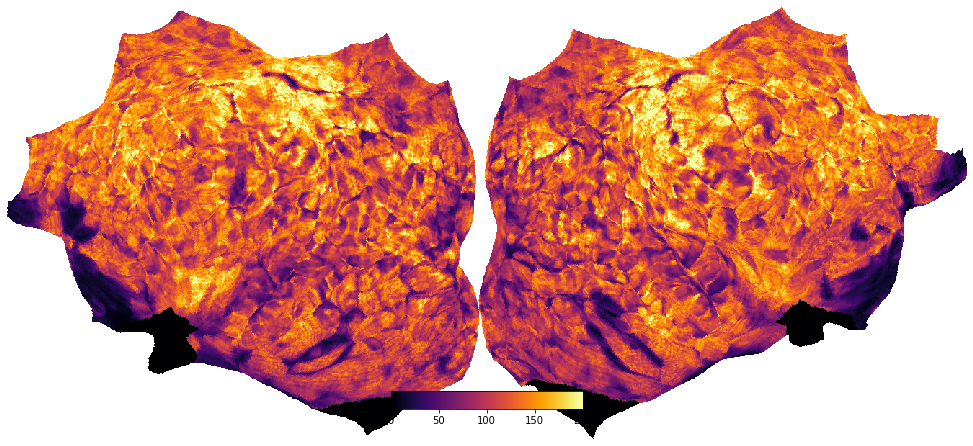

...

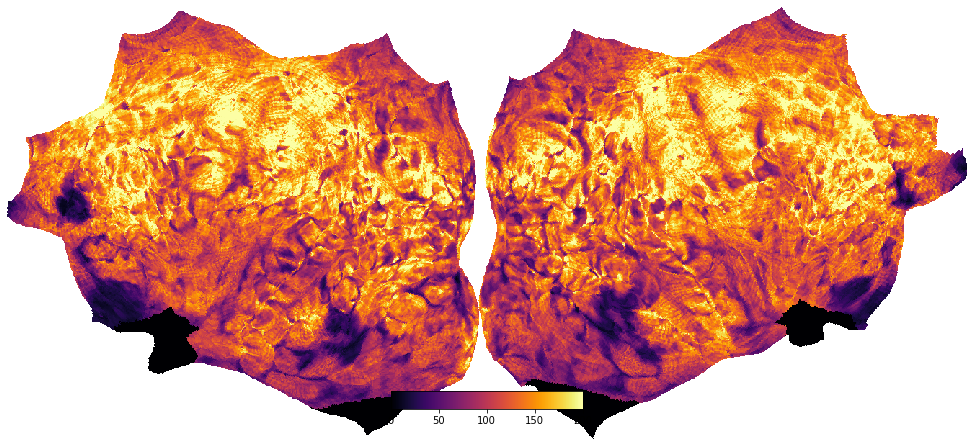

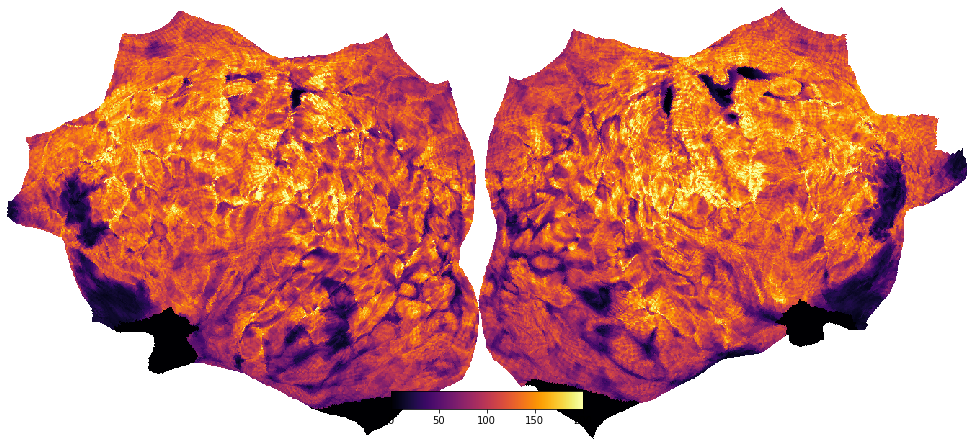

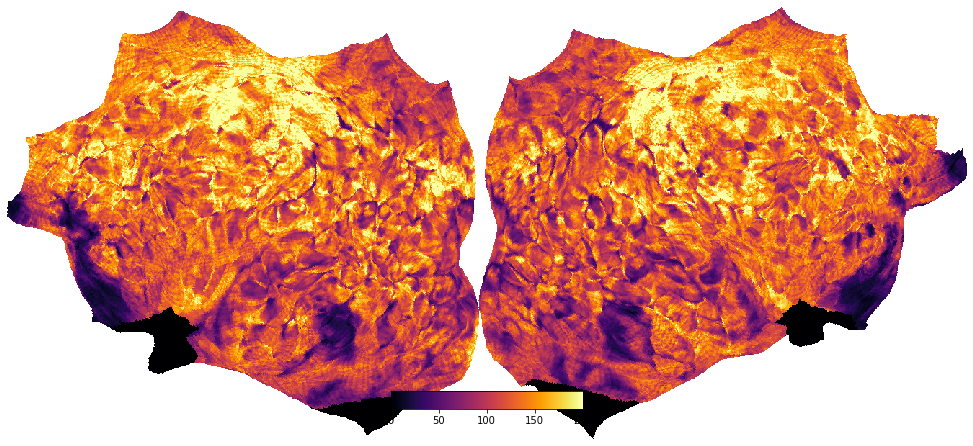

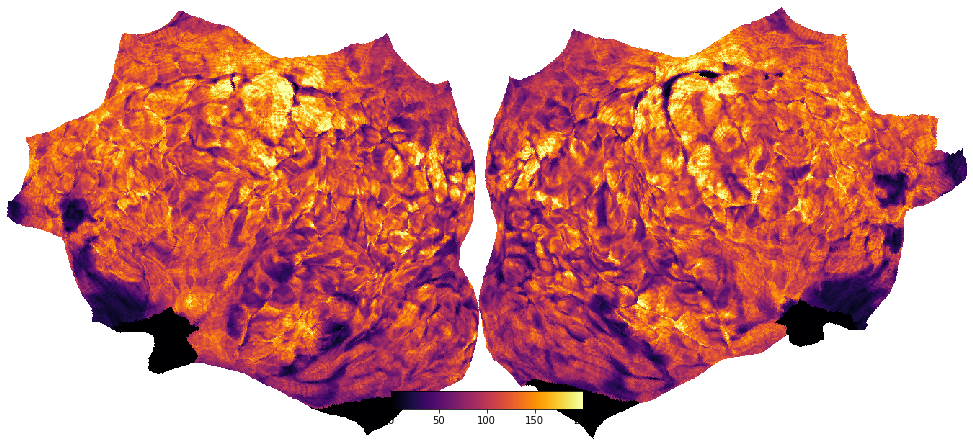

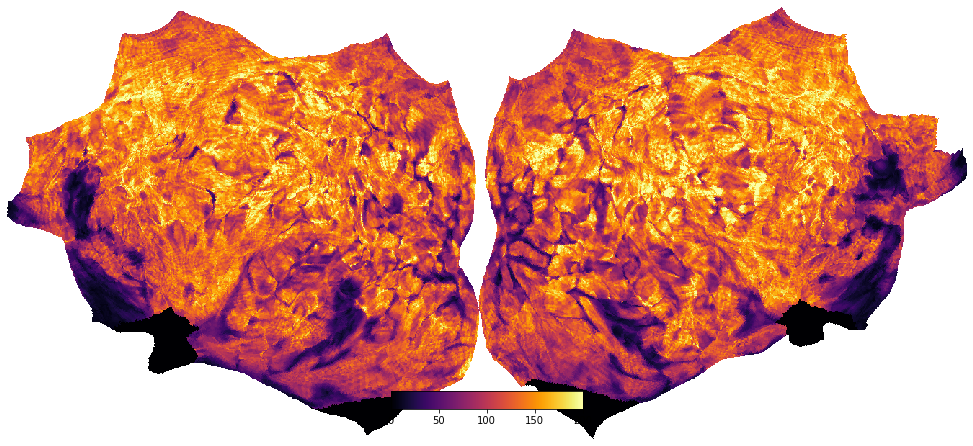

In [25]:
for m in median_tsnr_both:
    data = cortex.Vertex(m, 'fsaverage', vmin=0, vmax=200, cmap='inferno');
    cortex.quickflat.make_figure(data, with_rois=False, height=600);